# SCANPY - PAGA - Differential analysis

In [1]:
#conda activate scRNA
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
from matplotlib import rcParams
import scanpy as sc
import os
import csv
from astropy.io import ascii
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.cluster import DBSCAN
import warnings
from matplotlib_venn import venn3

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

warnings.filterwarnings('ignore')
code_dir = os.getcwd()
code_dir
sc.logging.print_versions()

/home/pipkin/anaconda3/envs/scanpy/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


scanpy==1.4.5.1 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.1 scikit-learn==0.22.2.post1 statsmodels==0.11.1 python-igraph==0.8.0 louvain==0.6.1


-----

### Info: Exp391 Expressional Level Differential Analysis
1. **Cluster v.s. Cluster** <br>
    1.1 One v.s. all <br>
    1.2 One v.s. one (with all cells) <br>
    1.3 One v.s. one (Cl13) <br>
    1.4 One v.s. one (Arm) <br>


2. **Armstrong v.s. Clone13** <br>
    2.1 Armstrong v.s. Clone13 v.s. Naive in all cells <br>
    2.2 Armstrong v.s. Clone13 in each cluster <br>
    2.3 Armstrong v.s. Clone13 in each time point (day5, day8) <br>
    2.4 Conditions v.s. Condition (Armstrong / Clone13 / Naive each time point one v.s. one)

---

## 0. Read object

In [2]:
wk_dir = "/media/pipkin/Yolanda/Exp391_Acute-Chronic_SC/1_1_SCANPY_PAGA/all--numSlt-rmWTNAV"
os.chdir(wk_dir)

adata = sc.read_h5ad("Exp391.h5ad")

In [3]:
features_df = pd.read_csv('/media/pipkin/Yolanda/Exp391_Acute-Chronic_SC/1_0_cellranger_outs/outs/filtered_feature_bc_matrix/features.tsv', 
                          header=None, sep='\t')
all_genes = list(features_df[1])

In [4]:
gene_n = len(adata.var)
gene_n

2907

sc.pl.violin(adata, 'G6pdx', groupby="louvain_newlabel", save="G6pdx_violin.png")
sc.pl.violin(adata, 'Mki67',groupby="louvain_newlabel", save="Mki67_violin.png")
sc.pl.paga(adata, color=['louvain'], save="node_plot.pdf")

-----

<h1><font size="8"><center> 1. Cluster versus Cluster </center></font></h1>

In [7]:
# Working directory of Arm v.s. cl13 comparison
wk_dir = "/media/pipkin/Yolanda/Exp391_Acute-Chronic_SC/1_1_SCANPY_PAGA/all--numSlt-rmWTNAV/1_DifferentialAnalysis/Cluster_vs_Cluster"
os.chdir(wk_dir)

# Get set of labels
louvain_newlabel_uniq = list(set(adata.obs['louvain_newlabel']))
louvain_newlabel_uniq.sort()
louvain_newlabel_uniq

### Config
labels_uniq = louvain_newlabel_uniq
obs_useCol = 'louvain_newlabel'

# 1.1 Differential Analysis for All Clusters

In [11]:
all_dir = "%s/all"%wk_dir
if not os.path.exists(all_dir):
    os.mkdir(all_dir)
os.chdir(all_dir)

### 1.1.1 T-test

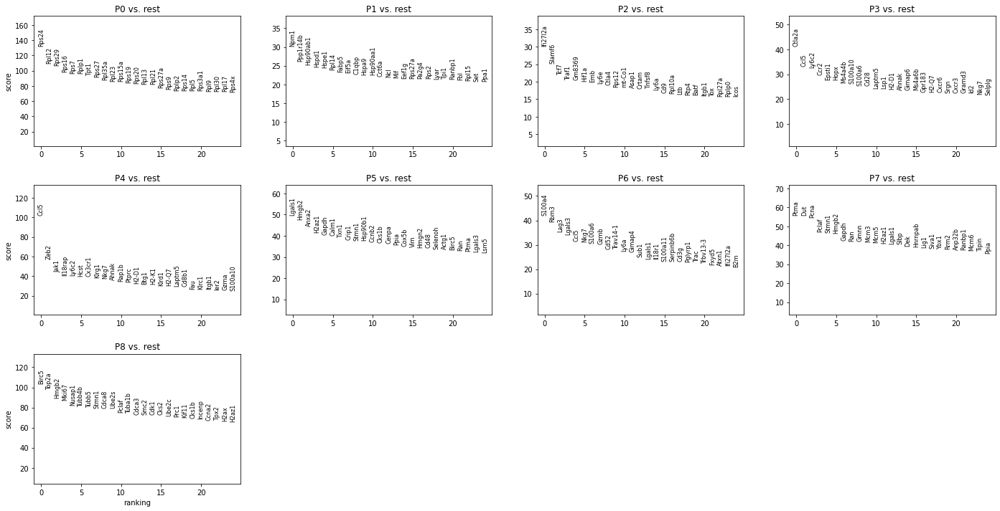

In [12]:
sc.tl.rank_genes_groups(adata, obs_useCol, method='t-test', key_added='t-test',n_genes=gene_n)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key='t-test')

### 1.1.2 T-test overestimated variance

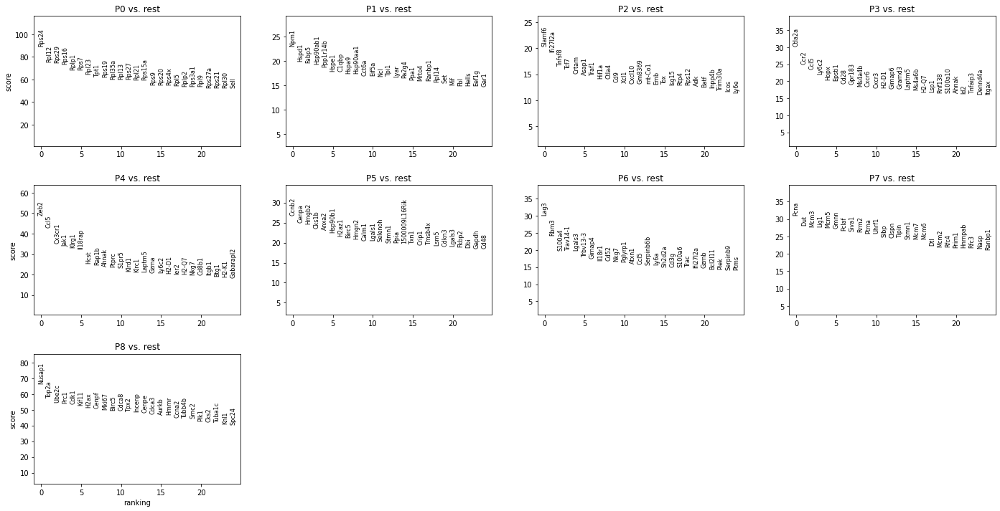

In [13]:
sc.tl.rank_genes_groups(adata, obs_useCol, method='t-test_overestim_var', key_added = "t-test_ov",n_genes=gene_n)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "t-test_ov")

### 1.1.3 Wilconxon rank-sum

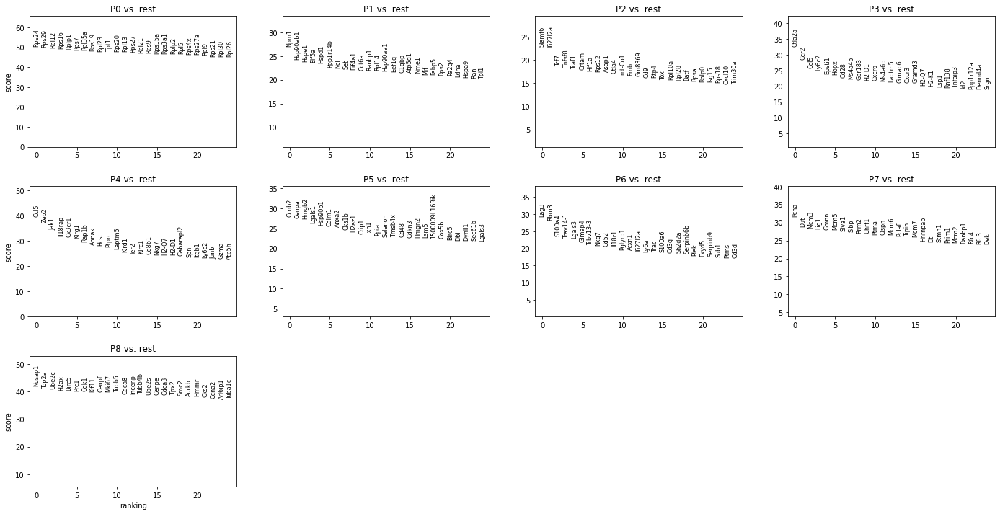

In [14]:
sc.tl.rank_genes_groups(adata, obs_useCol, method='wilcoxon', key_added = "wilcoxon",n_genes=gene_n)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key="wilcoxon")

### 1.1.4 Logistic regression

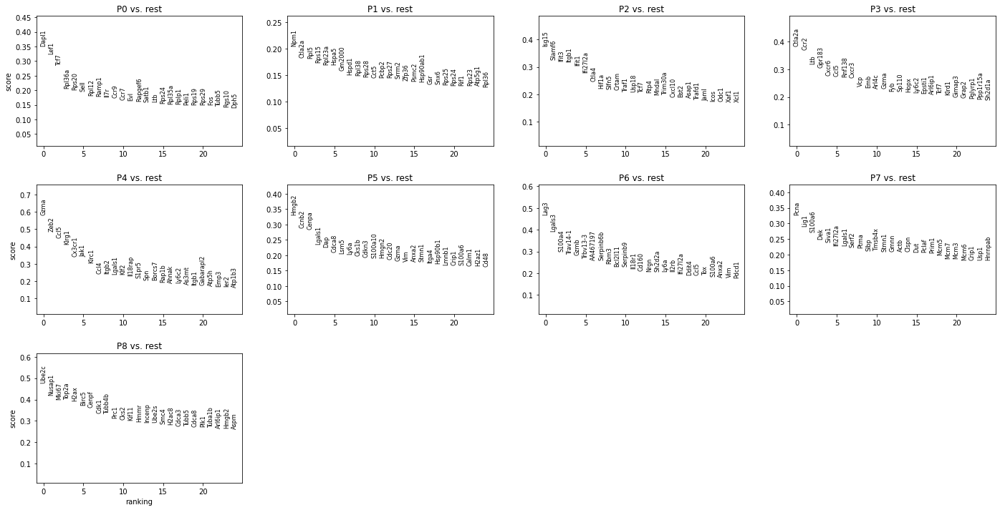

In [15]:
sc.tl.rank_genes_groups(adata, obs_useCol, method='logreg',key_added = "logreg",n_genes=gene_n)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key = "logreg")

### 1.1.5 Compare genes

In [16]:
###Redo
cps = ['wilcoxon', 't-test', 't-test_ov']


for l_t in louvain_newlabel_uniq:
    genes_df_l_t = pd.DataFrame({"gene_names":all_genes})
    dict_l_t = {}
    for cp in cps:
        cp_names = adata.uns[cp]['names'][l_t]
        cp_fc = adata.uns[cp]['logfoldchanges'][l_t]
        cp_score = adata.uns[cp]['scores'][l_t]
        cp_padj = adata.uns[cp]['pvals_adj'][l_t]
        if (cp == 't-test_ov'):
            cp_name = 't-test_overestim_var'
            cp_df = pd.DataFrame({"gene_names":cp_names, "%s_logfc"%cp_name: cp_fc, "%s_padj"%cp_name:cp_padj, "%s_score"%cp_name:cp_score})
        else:
            cp_df = pd.DataFrame({"gene_names":cp_names, "%s_logfc"%cp: cp_fc, "%s_padj"%cp:cp_padj, "%s_score"%cp:cp_score})
        #cp_df = cp_df[cp_df['%s_padj'%cp]<= 0.05]
        genes_df_l_t = pd.merge(genes_df_l_t, cp_df, how='outer', on="gene_names")
        dict_l_t[cp] = cp_df['gene_names']
    genes_df_l_t.to_csv("%s_differential.csv"%l_t, index=False)
    
    venn3([set(dict_l_t[cps[0]]), set(dict_l_t[cps[1]]), set(dict_l_t[cps[2]])], tuple(cps))
    
    outname = "%s_venn.png"%l_t
    plt.savefig(outname)
    plt.close()

### 1.1.6 Visualization

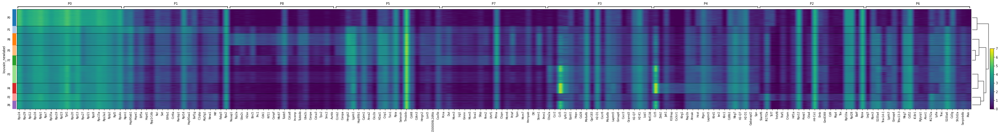

In [12]:
heatmap = sc.pl.rank_genes_groups_heatmap(adata, n_genes=20, key="wilcoxon", groupby=obs_useCol, 
                                          show_gene_labels=True,save="wilconxon_heatmap.png")

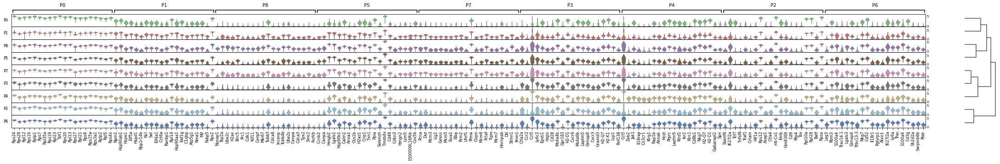

In [13]:
sc.pl.rank_genes_groups_stacked_violin(adata, n_genes=20, key="wilcoxon", groupby=obs_useCol,
                                      save="wilconxon_violin.png")

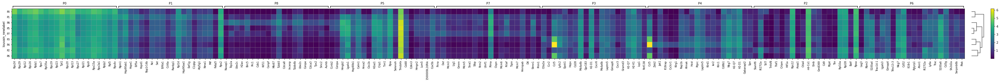

In [14]:
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=20, key="wilcoxon", groupby=obs_useCol,
                                  save="wilconxon_matrix.png")

-----
# 1.2 Compare specific clusters

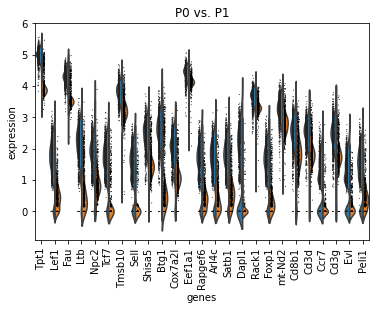

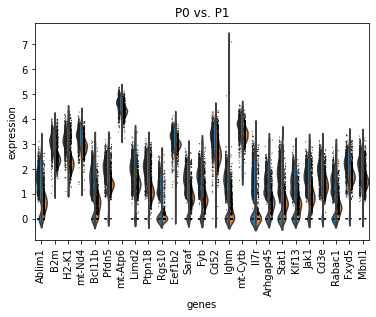

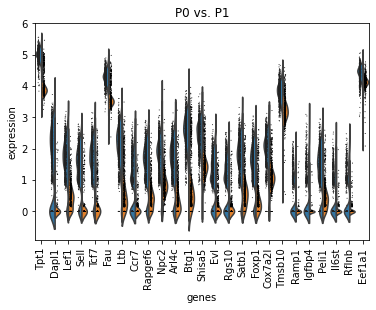

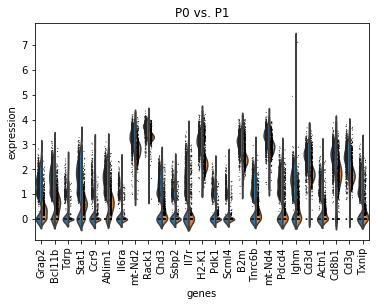

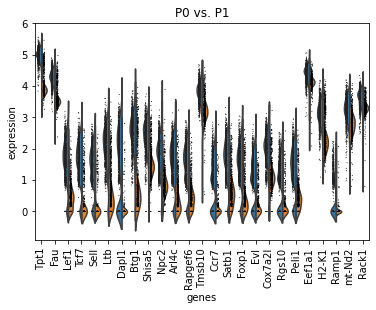

...

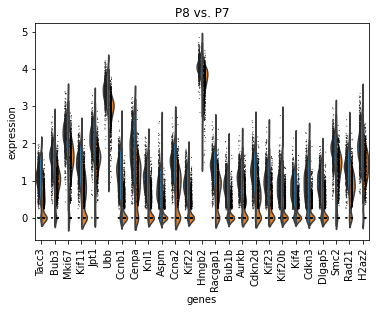

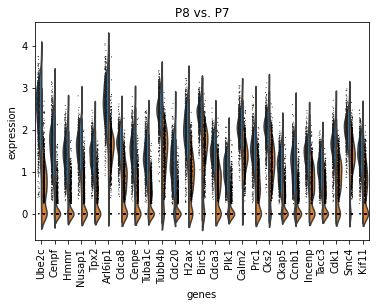

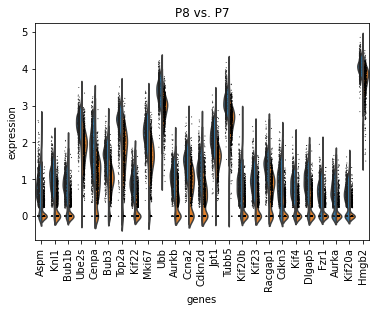

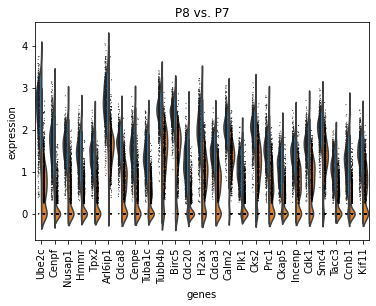

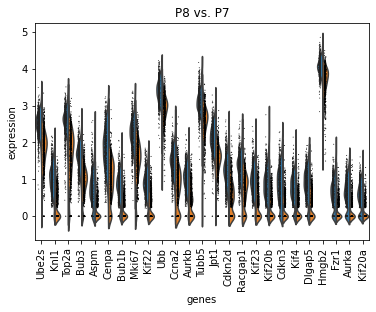

In [15]:
cps = ['wilcoxon', 't-test', 't-test_overestim_var']


for l_t_1 in labels_uniq:
    # Make a new folder for each cluster
    os.chdir(wk_dir)
    if not os.path.exists(l_t_1):
        os.mkdir(l_t_1)
    os.chdir(l_t_1)
    
    for l_t_2 in labels_uniq:
        if l_t_2 != l_t_1:
            
            # Test result summary dataframe
            genes_df_l_t = pd.DataFrame({"gene_names":all_genes})
            dict_l_t = {}
            for cp in cps:
                # Run test
                sc.tl.rank_genes_groups(adata, obs_useCol, groups=[l_t_1], reference=l_t_2, method=cp, n_genes=gene_n)

                # Build dataframe with test results
                cp_names = [x[0] for x in adata.uns['rank_genes_groups']['names']]
                cp_fc = [x[0] for x in adata.uns['rank_genes_groups']['logfoldchanges']]
                cp_score = [x[0] for x in adata.uns['rank_genes_groups']['scores']]
                cp_padj = [x[0] for x in adata.uns['rank_genes_groups']['pvals_adj']]
                cp_df = pd.DataFrame({"gene_names":cp_names, "%s_logfc"%cp: cp_fc, "%s_padj"%cp:cp_padj, "%s_score"%cp:cp_score})
                #cp_df = cp_df[cp_df['%s_padj'%cp]<= 0.05]

                # Plot top 50 differential genes
                diff = cp_df['gene_names']
                diff_rmRp = [x for x in list(diff) if not x.startswith("Rp")]
                if (len(diff_rmRp) >= 25):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[:25], 
                                                   save="_vs_%s--%s-25.png"%(l_t_2, cp))
                if (len(diff_rmRp) >= 50):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[25:50], 
                                                   save="_vs_%s--%s-50.png"%(l_t_2, cp))

                # Merge with total dataframe
                genes_df_l_t = pd.merge(genes_df_l_t, cp_df, how='outer', on="gene_names")
                dict_l_t[cp] = cp_df['gene_names']
            
            # Save results for all tests
            genes_df_l_t.to_csv("%s_vs_%s_differential.csv"%(l_t_1, l_t_2), index=False)
            
            # Test comparison venn diagram
            venn3([set(dict_l_t[cps[0]]), set(dict_l_t[cps[1]]), set(dict_l_t[cps[2]])], tuple(cps))

            outname = "%s_vs_%s_venn.png"%(l_t_1, l_t_2)
            plt.savefig(outname)
            plt.close()